In [1]:
import pandas as pd
import numpy as np
# !pip install catboost
from catboost import CatBoostRegressor, Pool
import xgboost as xgb


import os
import json
import pickle
from bisect import bisect_left, bisect_right
from datetime import datetime, timedelta
from collections import defaultdict, Counter

import numpy as np
import pandas as pd
from tqdm import tqdm

In [2]:
# !unzip '/content/drive/My Drive/hackathon_data.zip'

In [3]:
# '''
# acc = pd.read_csv('/content/hackathon_data/avk_hackathon_data_account_x_balance.csv')
# prod = pd.read_csv('/content/hackathon_data/avk_hackathon_data_party_products.csv')
# socdem = pd.read_csv('/content/hackathon_data/avk_hackathon_data_party_x_socdem.csv')
# logs = pd.read_csv('/content/hackathon_data/avk_hackathon_data_story_logs.csv')
# story = pd.read_csv('/content/hackathon_data/avk_hackathon_data_story_texts.csv')
# trans = pd.read_csv('/content/hackathon_data/avk_hackathon_data_transactions.csv')
# '''
# transaction_path = '/content/hackathon_data/avk_hackathon_data_transactions.csv'

In [4]:
DATADIR = "/gpfs/gpfs0/k.gizatullin/hackathon_data/" # "./data"
transactions_path = f"{DATADIR}/avk_hackathon_data_transactions.csv"


In [5]:
df = pd.read_csv(f"{DATADIR}users_spendings_per_week.csv")

In [6]:
df_sr = pd.read_csv(f"{DATADIR}/active_users_spendings_10k_trh.csv")
df_n = pd.read_csv(f"{DATADIR}/active_users_spendings.csv")

In [7]:
df.head()

,1,5,7,8,9,11,13,14,15,20,...,94594,94595,94598,94600,94602,94603,94606,94607,94608,94610
0,0.0,18177.15,0.00,0.0,0.0,0.0,0.00,0.0,0.0,1330.0,...,0.0,0.0,0.0,0.0,0.0,0.00,0.0,2026.0,0.00,0.0
1,0.0,2344.72,0.00,0.0,0.0,0.0,15055.00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00,3053.7,0.0,631.17,0.0
2,0.0,4387.67,0.00,0.0,0.0,0.0,28300.00,0.0,0.0,25877.0,...,0.0,0.0,0.0,0.0,5200.0,0.00,1553.9,0.0,0.00,0.0
3,0.0,0.00,3303.33,0.0,0.0,0.0,485.22,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,368.0,992.49,1281.1,0.0,0.00,0.0
4,0.0,9762.82,0.00,3935.0,0.0,0.0,0.00,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.00,504.0,0.0,0.00,0.0


In [8]:
cleaned_users_spendings_per_week = df.dropna()
active_users_mask = (cleaned_users_spendings_per_week.values==0)
active_users_mask = (np.sum(active_users_mask, axis=0)==0)
active_users_mask = cleaned_users_spendings_per_week.columns[active_users_mask]

In [9]:
df = cleaned_users_spendings_per_week[active_users_mask]

In [10]:
df.shape

(52, 1295)

In [11]:
df.head()

,143,555,706,756,794,807,850,904,940,948,...,64550,65427,72618,75514,81882,84365,92633,93039,93158,93748
0,843.68,706.51,361.48,2003.33,6612.68,23850.4,19463.17,3861.44,5586.82,2361.98,...,23149.64,7824.94,1874.17,160.0,1490.90,5154.10,6792.73,7377.94,3896.41,15840.0
1,1135.93,5334.67,993.00,935.35,7337.82,5335.1,14403.40,17046.00,5375.15,12422.33,...,28325.91,2643.77,5959.02,70.0,10580.61,1173.86,1941.80,4511.31,36407.34,2959.0
2,788.89,613.46,258.50,3176.53,13400.74,38421.0,6727.59,2640.55,212.98,3230.88,...,8438.29,1747.29,3740.85,1192.0,804.19,4888.63,1903.91,2138.69,26770.68,386.0
3,10715.35,11367.66,6417.67,2596.60,4545.01,9846.7,17267.72,12737.00,107.07,3457.52,...,2703.95,7080.34,3704.50,259.0,1646.98,3060.14,922.37,7659.34,3270.60,2422.2
4,1172.45,2627.09,877.00,4897.09,1053.00,37989.5,7499.69,21876.31,10824.43,4690.80,...,6154.25,6335.85,3552.70,324.0,49.99,9162.54,2537.74,3108.62,654.00,105.0


In [13]:
def get_cols_to_id(df):
    cols = df.columns
    df = df.T
    df['party_rk'] = cols
    df.reset_index(inplace=True, drop=True)
    cols = list(df.columns)
    cols = [cols[-1]] + cols[:-1]
    df = df[cols]
    return df

df = get_cols_to_id(df)

In [14]:
df.shape

(1295, 53)

In [41]:
y = df[40]

In [42]:
y_1 = df[39]
y_2 = df[40]
y_3 = df[41]
y_4 = df[42]

In [43]:
df.drop([39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51], axis=1, inplace=True)

In [44]:
id = df['party_rk']
df.drop(['party_rk'], axis=1, inplace=True)

KeyError: 'party_rk'

In [45]:
(df.mean()).mean()

9480.474249845603

In [46]:
df['mean'] = df.mean(axis=1)

In [47]:
def get_cols_to_id(df):
    cols = df.columns
    df = df.T
    df['party_rk'] = cols
    df.reset_index(inplace=True, drop=True)
    cols = list(df.columns)
    cols = [cols[-1]] + cols[:-1]
    df = df[cols]
    return df

df = get_cols_to_id(df)

In [48]:
df.head()

,party_rk,0,1,2,3,4,5,6,7,8,...,30,31,32,33,34,35,36,37,38,39
0,0,843.68,1135.93,788.89,10715.35,1172.45,710.48,2160.00,9074.42,17627.58,...,2744.50,5819.05,8955.87000,4171.84,8535.69,38608.00,28100.00,1994.33,16556.03,6640.502308
1,1,706.51,5334.67,613.46,11367.66,2627.09,1379.81,2408.12,7321.88,1707.18,...,4042.97,1209.44,13626.59000,7877.68,9666.40,7472.80,14215.69,5693.20,11199.36,13429.124615
2,2,361.48,993.00,258.50,6417.67,877.00,181.00,3114.00,3047.93,6680.65,...,903.00,20439.97,4266.28000,22206.98,10615.63,3299.00,3646.58,7339.28,4066.04,4328.789487
3,3,2003.33,935.35,3176.53,2596.60,4897.09,3465.47,3151.34,2598.33,1773.04,...,3036.40,822.90,607.81000,3377.73,315.00,1115.98,2418.48,4980.87,3781.73,3536.515641
4,4,6612.68,7337.82,13400.74,4545.01,1053.00,1672.09,6644.78,7138.55,3574.23,...,29504.51,10652.00,12514.28042,12639.82,4178.05,11100.94,14427.74,19503.95,7759.60,9324.923088


In [22]:
df.shape

(40, 1296)

In [24]:
# y.shape

In [25]:
df.shape

(40, 1296)

In [26]:
df.head()

,party_rk,0,1,2,3,4,5,6,7,8,...,1285,1286,1287,1288,1289,1290,1291,1292,1293,1294
0,0,843.68,706.51,361.48,2003.33,6612.68,23850.4,19463.17,3861.44,5586.82,...,23149.64,7824.94,1874.17,160.0,1490.90,5154.10,6792.73,7377.94,3896.41,15840.0
1,1,1135.93,5334.67,993.00,935.35,7337.82,5335.1,14403.40,17046.00,5375.15,...,28325.91,2643.77,5959.02,70.0,10580.61,1173.86,1941.80,4511.31,36407.34,2959.0
2,2,788.89,613.46,258.50,3176.53,13400.74,38421.0,6727.59,2640.55,212.98,...,8438.29,1747.29,3740.85,1192.0,804.19,4888.63,1903.91,2138.69,26770.68,386.0
3,3,10715.35,11367.66,6417.67,2596.60,4545.01,9846.7,17267.72,12737.00,107.07,...,2703.95,7080.34,3704.50,259.0,1646.98,3060.14,922.37,7659.34,3270.60,2422.2
4,4,1172.45,2627.09,877.00,4897.09,1053.00,37989.5,7499.69,21876.31,10824.43,...,6154.25,6335.85,3552.70,324.0,49.99,9162.54,2537.74,3108.62,654.00,105.0


In [27]:
df[5].describe()

count        40.000000
mean      44301.578974
std       67512.081833
min        1898.000000
25%        8831.365000
50%       12378.800000
75%       47328.809231
max      294529.960000
Name: 5, dtype: float64

In [39]:
party_rk = df['party_rk']
df.drop(['party_rk'], axis=1, inplace=True)

KeyError: 'party_rk'

In [40]:
from sklearn.metrics import mean_absolute_error as mae
from sklearn.model_selection import train_test_split

In [30]:
def get_pool_data(df, y):
    train = Pool(df, y)
    test = Pool(df)
    return train, test

In [32]:
train, test = get_pool_data(df, y)

In [34]:
# train.shape, test.shape

In [35]:
iter = 20000
seed = 42
l2 = 0.5
model = CatBoostRegressor(iterations=iter, task_type = 'GPU', random_seed=seed, verbose = 500, l2_leaf_reg=l2, depth=8)

In [36]:
model.fit(train, plot = True)

NameError: name 'train' is not defined

In [ ]:
y_pred = model.predict(test)
mae(y, y_pred)

3361.16989250143

In [ ]:
import matplotlib.pyplot as plt


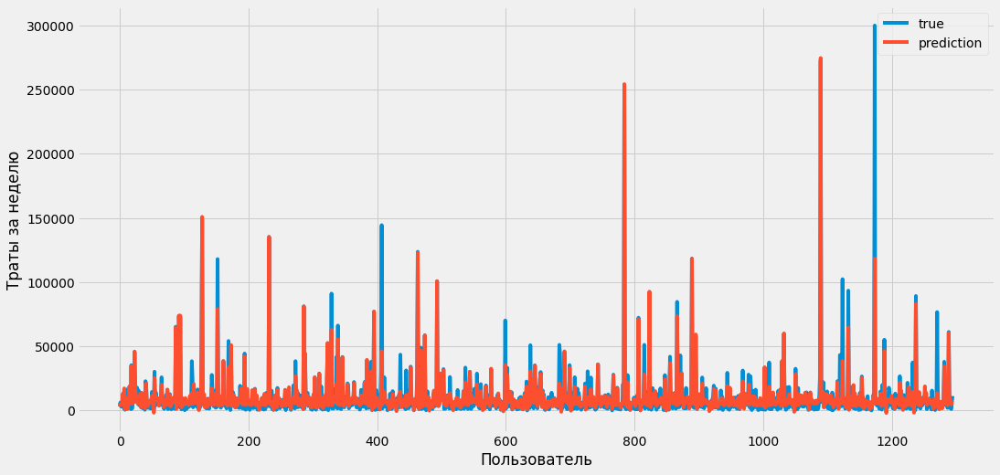

In [ ]:
plt.figure(figsize=(16, 8))
plt.style.use('fivethirtyeight')

plt.plot(y, label = 'true')
plt.plot(y_pred, label = 'prediction')
plt.xlabel('Пользователь')
plt.ylabel('Траты за неделю')
plt.legend()

In [ ]:
len(y_pred), len()

1295

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/catboost_info

<IPython.core.display.Javascript object>

In [ ]:
y_pred = model.predict(test)

In [ ]:
mae(y_true, y_pred)

In [ ]:
y_true.shape

(49083,)

In [ ]:
y_pred.shape

(9817,)

In [ ]:
y_pred

array([5802.08643973, 4034.0711203 , 4508.49611181, ..., 4691.08846665,
       7627.8036808 , 7838.03764004])

In [ ]:
df[39] = y_1

In [ ]:
train, test = get_pool_data(df, y_2)

In [ ]:
model.fit(train, plot = True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 18557.3566484	total: 45.1ms	remaining: 15m 2s
500:	learn: 9563.6920197	total: 6.96s	remaining: 4m 30s
1000:	learn: 8755.4823590	total: 15.8s	remaining: 5m
1500:	learn: 8740.7431592	total: 20.1s	remaining: 4m 8s
2000:	learn: 8610.4222454	total: 27.4s	remaining: 4m 6s
2500:	learn: 8547.7503952	total: 34s	remaining: 3m 58s
3000:	learn: 8483.6135260	total: 41.4s	remaining: 3m 54s
3500:	learn: 8266.7672986	total: 47.8s	remaining: 3m 45s
4000:	learn: 8007.3719733	total: 56.2s	remaining: 3m 44s
4500:	learn: 7980.4554833	total: 1m 2s	remaining: 3m 35s
5000:	learn: 7980.4531053	total: 1m 9s	remaining: 3m 27s
5500:	learn: 7819.4839277	total: 1m 17s	remaining: 3m 23s
6000:	learn: 7734.0475566	total: 1m 25s	remaining: 3m 19s
6500:	learn: 7413.2073328	total: 1m 35s	remaining: 3m 17s
7000:	learn: 7412.0761654	total: 1m 40s	remaining: 3m 6s
7500:	learn: 7379.2594612	total: 1m 47s	remaining: 2m 58s
8000:	learn: 7338.9645745	total: 1m 56s	remaining: 2m 55s
8500:	learn: 7338.9469043	total: 2m 

In [ ]:
y_pred_1 = model.predict(test)
print(mae(y_2, y_pred_1))

2225.3908228510622


In [ ]:
df[40] = y_2

In [ ]:
train, test = get_pool_data(df, y_3)

In [ ]:
model.fit(train, plot = True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 12269.2278747	total: 74.4ms	remaining: 24m 47s
500:	learn: 6271.4142347	total: 8.12s	remaining: 5m 15s
1000:	learn: 6092.5158235	total: 15s	remaining: 4m 44s
1500:	learn: 6058.0972850	total: 20.2s	remaining: 4m 8s
2000:	learn: 5837.6981765	total: 25.3s	remaining: 3m 47s
2500:	learn: 5822.5033335	total: 29.5s	remaining: 3m 26s
3000:	learn: 5816.2969296	total: 33.5s	remaining: 3m 10s
3500:	learn: 5816.2985611	total: 37.7s	remaining: 2m 57s
4000:	learn: 5799.3400109	total: 42.7s	remaining: 2m 50s
4500:	learn: 5790.6417913	total: 47.2s	remaining: 2m 42s
5000:	learn: 5632.6370998	total: 52.9s	remaining: 2m 38s
5500:	learn: 5607.9556947	total: 57.3s	remaining: 2m 30s
6000:	learn: 5122.0269347	total: 1m 7s	remaining: 2m 36s
6500:	learn: 4944.8821594	total: 1m 14s	remaining: 2m 34s
7000:	learn: 4839.2070418	total: 1m 19s	remaining: 2m 28s
7500:	learn: 4508.8211371	total: 1m 29s	remaining: 2m 29s
8000:	learn: 4499.3880308	total: 1m 35s	remaining: 2m 22s
8500:	learn: 4441.3658145	total

In [ ]:
y_pred_2 = model.predict(test)
print(mae(y_3, y_pred_2))

########## chng to y_3

2096.723022778432


In [ ]:
df[41] = y_3

In [ ]:
train, test = get_pool_data(df, y_4)

In [ ]:
model.fit(train, plot = True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 21464.7039374	total: 89.6ms	remaining: 29m 51s
500:	learn: 9719.1366247	total: 10s	remaining: 6m 30s
1000:	learn: 9591.2013630	total: 15.5s	remaining: 4m 54s
1500:	learn: 9218.6594190	total: 20.8s	remaining: 4m 16s
2000:	learn: 9218.4309106	total: 25.1s	remaining: 3m 45s
2500:	learn: 8590.4224489	total: 32.1s	remaining: 3m 44s
3000:	learn: 8392.5618460	total: 38.8s	remaining: 3m 39s
3500:	learn: 7935.7002808	total: 48s	remaining: 3m 46s
4000:	learn: 7775.8580917	total: 54.1s	remaining: 3m 36s
4500:	learn: 7775.8462956	total: 59.5s	remaining: 3m 24s
5000:	learn: 6807.1277656	total: 1m 8s	remaining: 3m 25s
5500:	learn: 6790.9023530	total: 1m 13s	remaining: 3m 13s
6000:	learn: 6593.0710979	total: 1m 21s	remaining: 3m 10s
6500:	learn: 6276.5858895	total: 1m 30s	remaining: 3m 8s
7000:	learn: 5987.4112466	total: 1m 39s	remaining: 3m 4s
7500:	learn: 5581.4311003	total: 1m 48s	remaining: 3m 1s
8000:	learn: 5414.2498076	total: 1m 58s	remaining: 2m 57s
8500:	learn: 5382.5469237	total: 

In [ ]:
y_pred_3 = model.predict(test)
print(mae(y_4, y_pred_3))

2673.8061964140816
